<a href="https://colab.research.google.com/github/LudwigBitHoven/Laplacify-app/blob/main/fun_with_jpg.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import matplotlib.pyplot as plt
from math import pi, e
import numpy as np
from skimage.io import imread, imshow
from skimage import img_as_float
from scipy.signal import convolve2d
from numpy.fft import fft2, fftshift

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
def conv(img, kernel):
    r, g, b = img[:, :, 0], img[:, :, 1], img[:, :, 2]
    r2, g2, b2 = convolve2d(r, kernel, mode='same'), convolve2d(g, kernel, mode='same'), convolve2d(b, kernel, mode='same')
    result = np.dstack((r2, g2, b2))
    return result


def gauss(x, y, sigma):
    return (1 / ((2 * pi) * sigma**2) * e**((- x**2 - y**2) / (2 * sigma**2)))


def get_freq(img):
    r, g, b = img[:, :, 0], img[:, :, 1], img[:, :, 2]
    Y = 0.299 * r + 0.587 * g + 0.114 * b
    freq = 20 * np.log(1 + abs(fftshift(fft2(Y))))
    return freq


def gauss_pyramid(img, sigma, n_layers):
    result = []
    k = int(round(6 * sigma + 1))
    core = np.array([[gauss(x, y, sigma) for x in range(-k, k + 1)] for y in range(-k, k + 1)])
    kernel = core / np.sum(core, axis=(0, 1))
    for i in range(n_layers):
        img = conv(img, kernel)
        img = np.clip(img, 0, 1)
        result.append(img)
    return np.array(result)


def show_gauss(img, sigma, n_layers):
  fig, ax = plt.subplots(n_layers, 2, figsize=(20, 30))
  for i in range(n_layers):
    ax[i][0].imshow(img[i])
    freq = get_freq(img[i])
    ax[i][1].imshow(freq, cmap='gray')
    ax[0][0].set_title(f'Сигма = {sigma}', fontsize=15)
    ax[0][1].set_title('Соответствующие частоты', fontsize=15)


def lap_pyramid(img, sigma, n_layers):
    g_img = [img]
    g = gauss_pyramid(img, sigma, n_layers)
    result = []
    for i in range(n_layers):
        g_img.append(g[i])
        pic = g_img[i] - g_img[i + 1]
        result.append(pic)
    result.append(g_img[-1])
    result = np.array(result)
    return result

def show_laplas(img, sigma, n_layers):
    fig, ax = plt.subplots(n_layers - 1, 2, figsize=(20, 30))
    for i in range(1, n_layers):
      ax[i - 1][0].imshow(np.clip(30 * img[i], 0, 1))
      freq = get_freq(img[i-1])
      freq2 = get_freq(img[i])
      ax[i - 1][1].imshow(freq - freq2, cmap='gray')
    ax[0][0].set_title(f'Сигма = {sigma}', fontsize=15)
    ax[0][1].set_title('Соответствующие частоты', fontsize=15)

In [5]:
! wget https://github.com/LudwigBitHoven/CS102/blob/Multimedia/homework00/1.jpg

--2024-03-19 12:31:17--  https://github.com/LudwigBitHoven/CS102/blob/Multimedia/homework00/1.jpg
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4836 (4.7K) [text/plain]
Saving to: ‘1.jpg’

1.jpg               100%[===================>]   4.72K  --.-KB/s    in 0s      

2024-03-19 12:31:17 (44.2 MB/s) - ‘1.jpg’ saved [4836/4836]



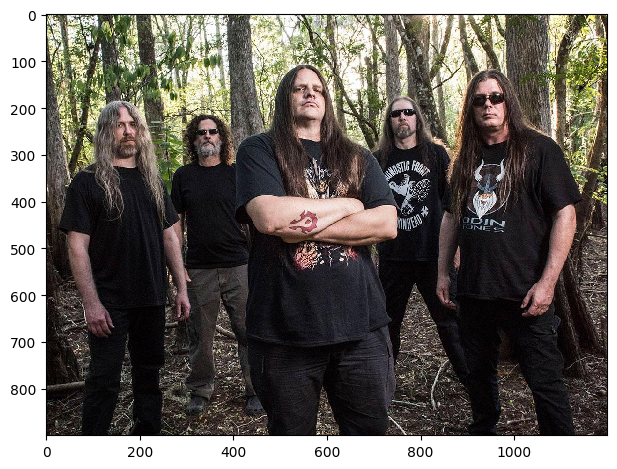

In [8]:
img = imread('./drive/MyDrive/jpg/1.jpg')
img = img_as_float(img)
imshow(img)

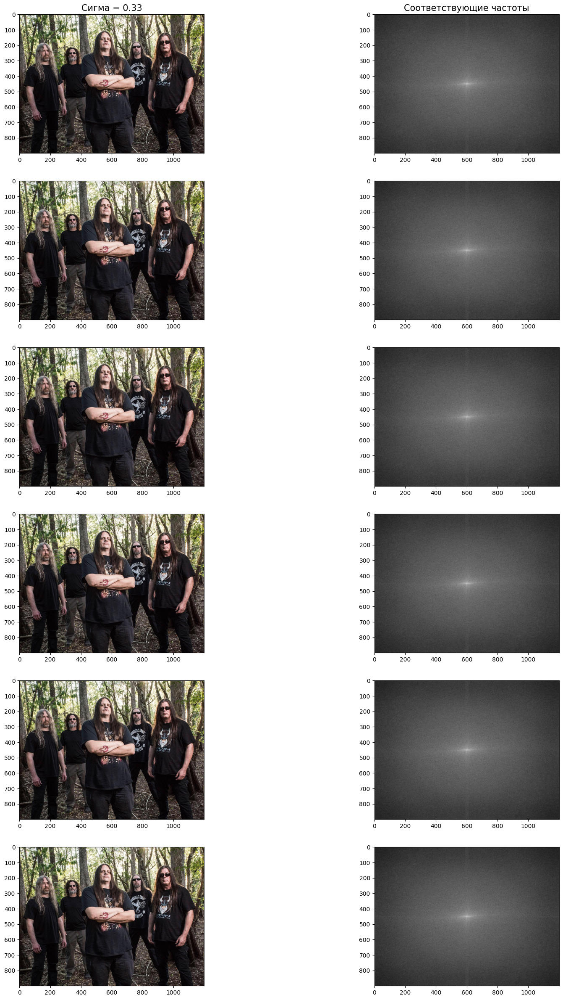

In [8]:
sigmas = [0.33, 0.66, 0.99]
n_layers = 6
show_gauss(gauss_pyramid(img, 0.33, n_layers), 0.33, n_layers)

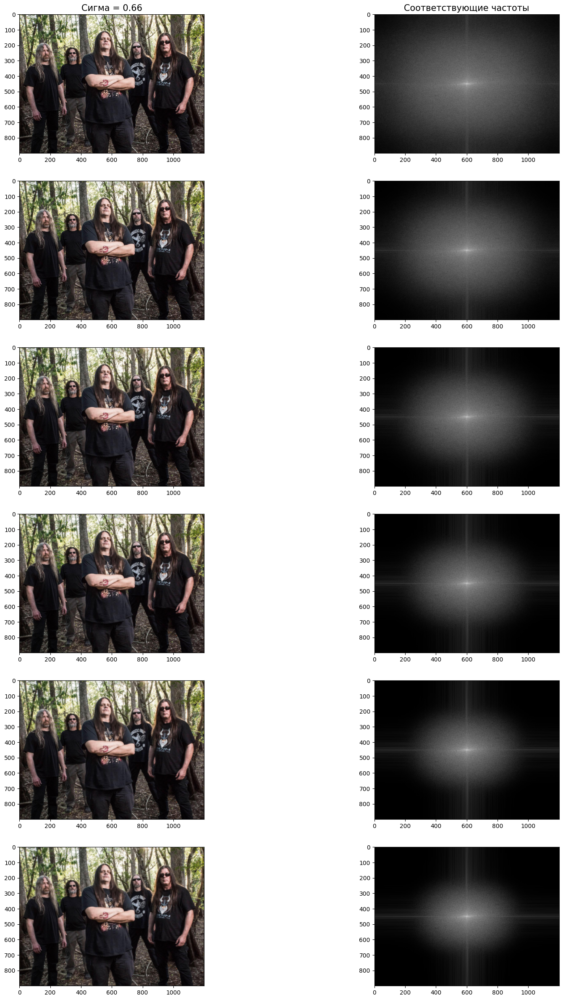

In [9]:
show_gauss(gauss_pyramid(img, 0.66, n_layers), 0.66, n_layers)

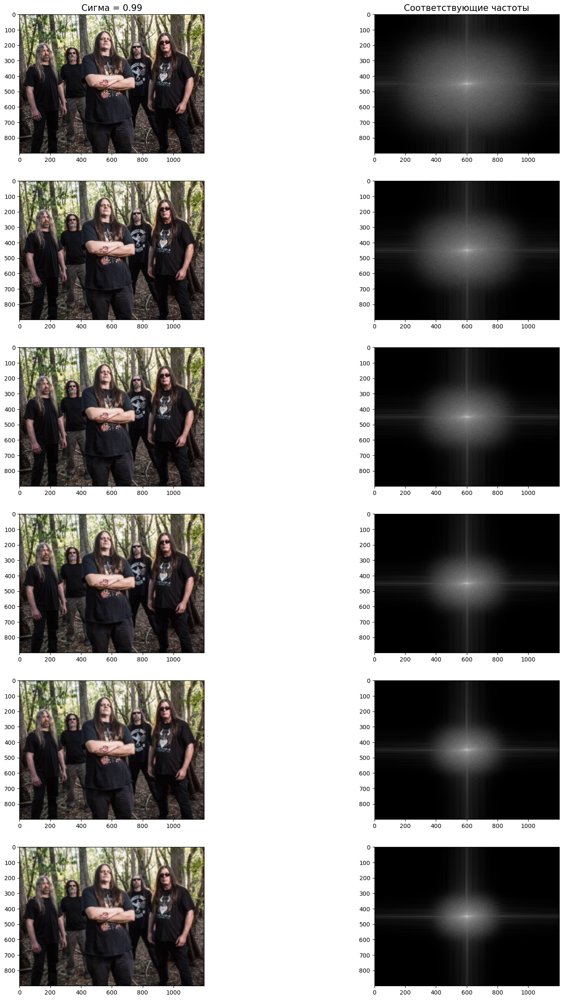

In [10]:
show_gauss(gauss_pyramid(img, 0.99, n_layers), 0.99, n_layers)

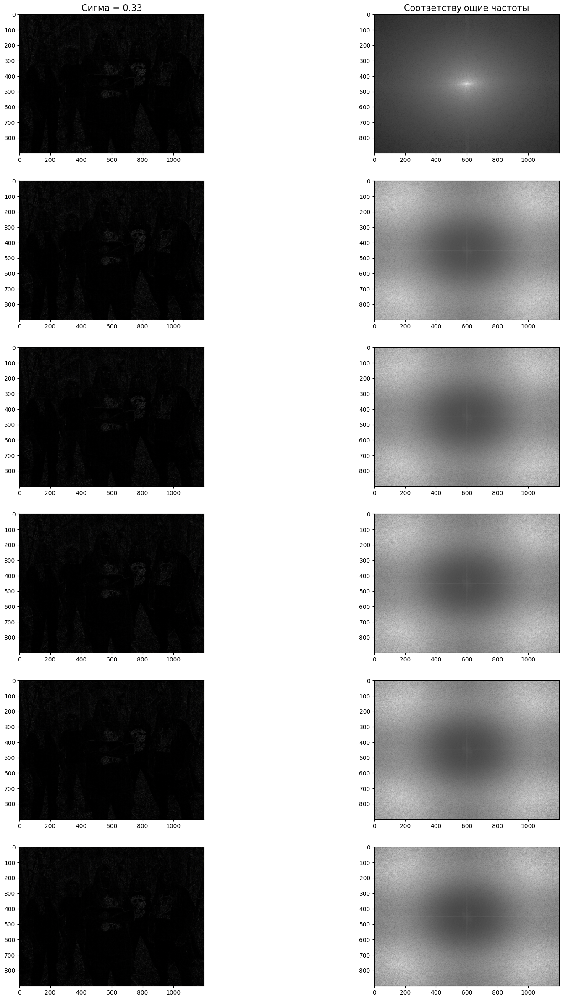

In [11]:
lap = [img]
l = lap_pyramid(img, 0.33, n_layers)
for i in range(n_layers):
    lap.append(l[i])

show_laplas(lap, 0.33, n_layers + 1)

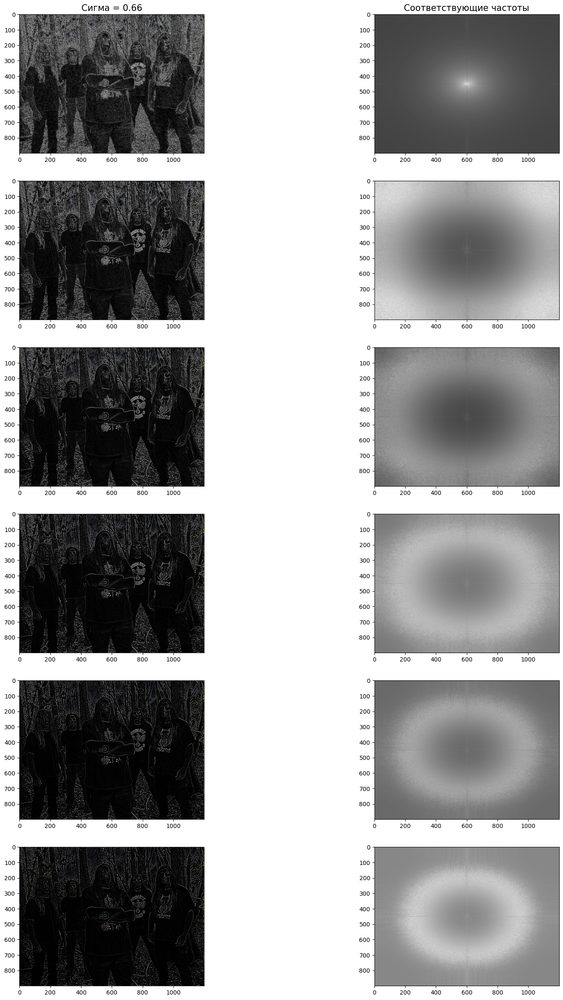

In [12]:
lap = [img]
l = lap_pyramid(img, 0.66, n_layers)
for i in range(n_layers):
    lap.append(l[i])

show_laplas(lap, 0.66, n_layers + 1)

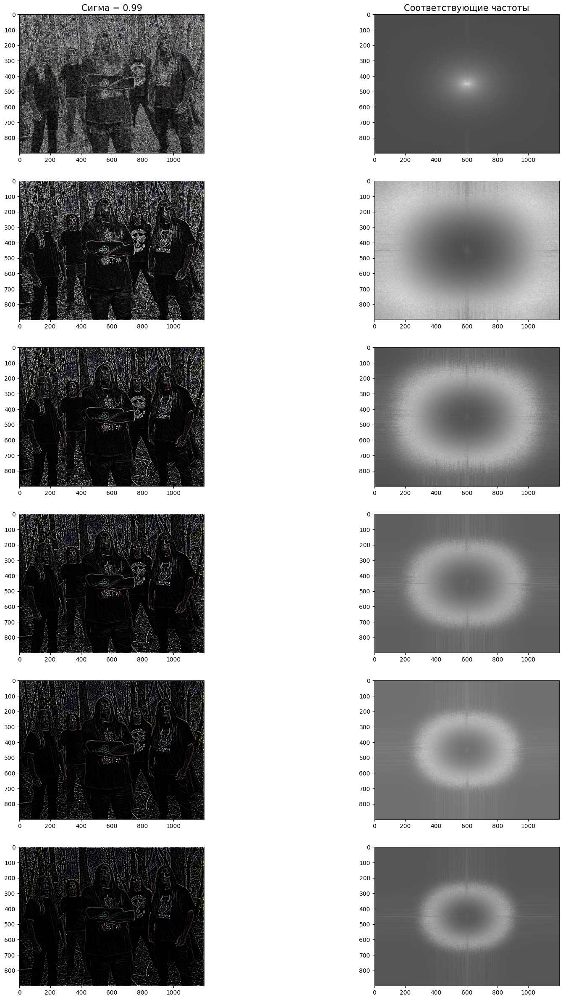

In [13]:
lap = [img]
l = lap_pyramid(img, 0.99, n_layers)
for i in range(n_layers):
    lap.append(l[i])

show_laplas(lap, 0.99, n_layers + 1)

In [ ]:
def stitch(img1, img2, mask, sigma, n_layers):
    LA = lap_pyramid(img1, sigma, n_layers)
    LB = lap_pyramid(img2, sigma, n_layers)
    GM = gauss_pyramid(mask, sigma, n_layers + 1)
    combine = LA * GM + (1 - GM) * LB
    result = np.clip(sum(combine), 0, 1)
    return [50 * combine, result]

def show_input(img1, img2, img3):
    fig, ax = plt.subplots(1, 3, figsize=(20, 20))
    ax[0].imshow(img1)
    ax[1].imshow(img2)
    ax[2].imshow(img3)
    ax[1].set_title('Исходные изображения', fontsize=25)

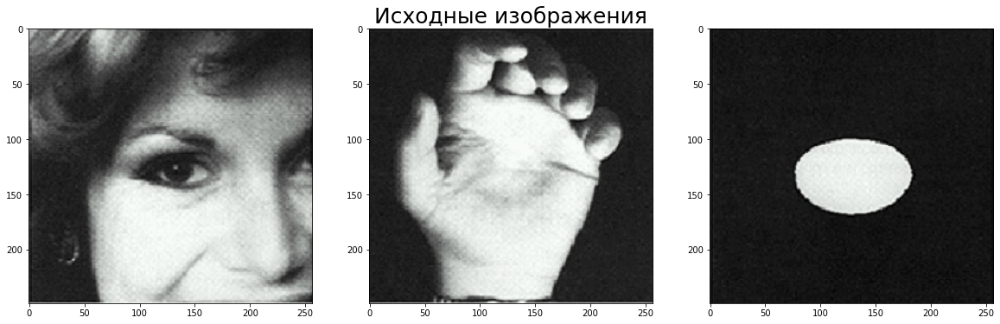

In [ ]:
i1 = img_as_float(imread('./drive/MyDrive/jpg/a.png'))
i2 = img_as_float(imread('./drive/MyDrive/jpg/b.png'))
mask = img_as_float(imread('./drive/MyDrive/jpg/mask.png'))
show_input(i1, i2, mask)
mask = (mask > 0.7).astype('uint')

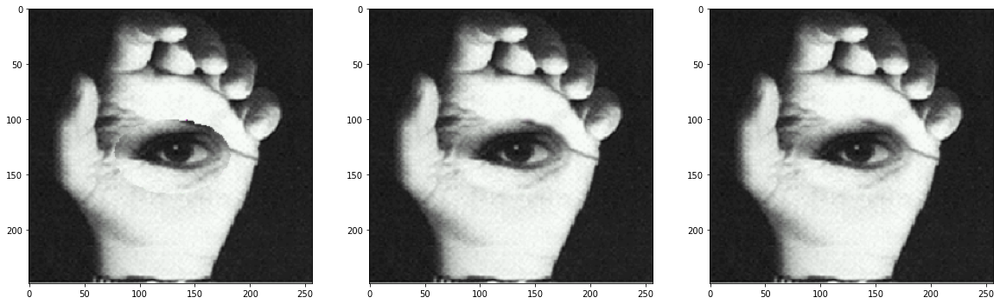

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(20, 20))
for i in range(3):
    ans = stitch(i1, i2, mask, sigmas[i], n_layers)[1]
    ax[i].imshow(ans)

Text(0.5, 1.0, 'Зависимость качества изображения от количества слоёв: [2, 8, 16]')

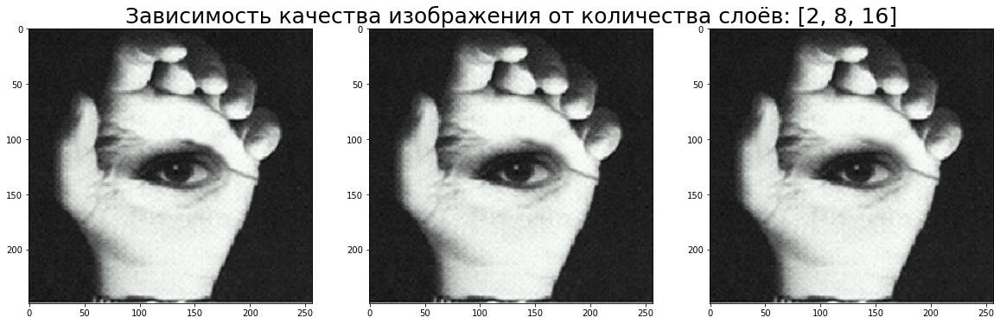

In [ ]:
sigma = 0.99
n_layer = [2, 8, 16]
fig, ax = plt.subplots(1, 3, figsize=(20, 20))
for i in range(3):
    ans = stitch(i1, i2, mask, sigma, n_layer[i])[1]
    ax[i].imshow(ans)
ax[1].set_title(f'Зависимость качества изображения от количества слоёв: {n_layer}', fontsize=25)

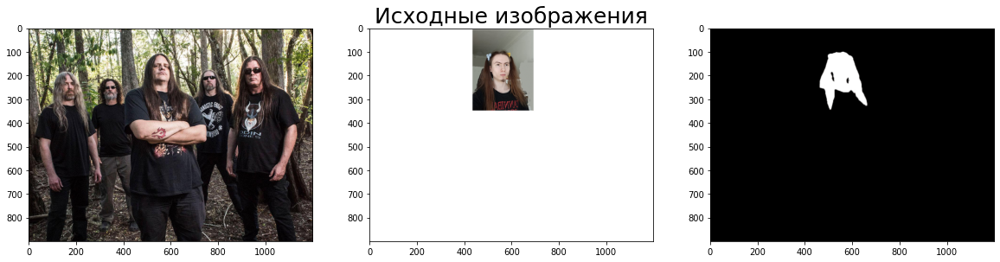

In [ ]:
mujiki = img_as_float(imread('./drive/MyDrive/jpg/1.jpg'))
malchik = img_as_float(imread('./drive/MyDrive/jpg/2.jpg'))
mask_malchik = img_as_float(imread('./drive/MyDrive/jpg/mask_1.jpg'))

show_input(mujiki, malchik, mask_malchik)

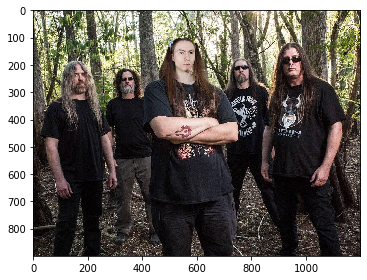

In [ ]:
imshow(stitch(malchik, mujiki, mask_malchik, 0.33, 2)[1])

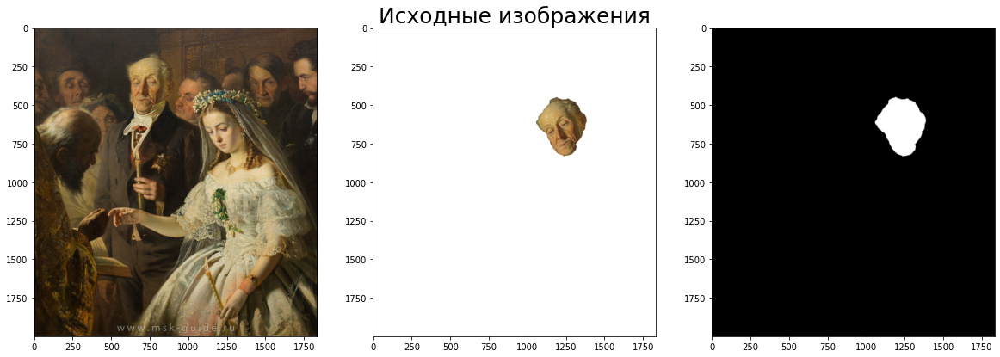

In [ ]:
# Уравним брак
unequal = img_as_float(imread('./drive/MyDrive/jpg/3.jpg'))
senior = img_as_float(imread('./drive/MyDrive/jpg/4.jpg'))
mask_senior = img_as_float(imread('./drive/MyDrive/jpg/mask_2.jpg'))

show_input(unequal, senior, mask_senior)

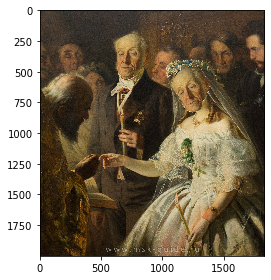

In [ ]:
imshow(stitch(senior, unequal, mask_senior, 0.33, 2)[1])

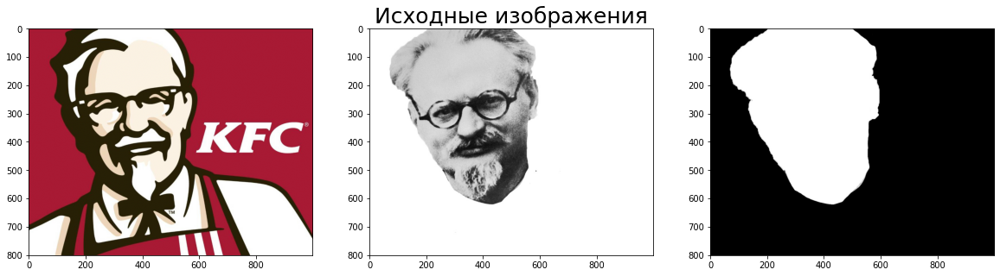

In [ ]:
# Kommunist fried chicken
sanders = img_as_float(imread('./drive/MyDrive/jpg/sanders.jpg'))
trotsky = img_as_float(imread('./drive/MyDrive/jpg/trotsky.jpg'))
mask_trotsky = img_as_float(imread('./drive/MyDrive/jpg/mask_trotsky.jpg'))

show_input(sanders, trotsky, mask_trotsky)

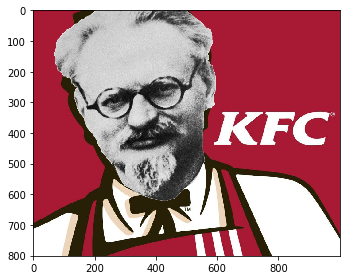

In [ ]:
imshow(stitch(trotsky, sanders, mask_trotsky, 0.33, 2)[1])